## ***Problem Definition***

The objective of this project is to predict customer churn that is, to identify whether a customer is likely to leave the bank or continue using its services. Customer churn is a critical problem in the banking industry, as retaining existing customers is more cost-effective than acquiring new ones. Given a dataset containing customer demographics, account information, and transactional behavior,    
#### ***I aim to:***

- Build a machine learning model that accurately classifies customers as likely to churn $(Exited = 1)$ or stay $(Exited = 0)$.
- Understand and identify the key drivers of customer churn.
- Provide actionable insights to the bank for developing targeted customer retention strategies.

$-$

#### ***Data Dictionary:***

- `CustomerId:` Unique identifier for each customer.
- `Lastname:` Customer's last name (not useful for prediction).
- `CreditScore:` Customer's credit rating.
- `Geography:` Country of the customer (France, Spain, Germany).
- `Gender:` Male or Female.
- `Age:` Customer's age.
- `Tenure:` Number of years the customer has been with the bank.
- `Balance:` Account balance.
- `NumOfProducts:` Number of products the customer has with the bank.
- `HasCrCard:` Whether the customer has a credit card $(1 = Yes, 0 = No)$.
- `IsActiveMember:` Whether the customer is an active member $(1 = Yes, 0 = No)$.
- `EstimatedSalary:` Customer's estimated salary.
- `Exited:` Target variable $(1 = Churned, 0 = Stayed)$.
***
***

## ***Essential libraries:***
***

In [11]:

# Data Handling
import numpy as np
import pandas as pd

# Data Visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

# Warnings and Styling
import warnings
warnings.filterwarnings('ignore')

#For setting plot styles
sns.set(style="whitegrid")


***

## ***Data Collection and Initial Data Inspection:***
***

In [2]:

data = pd.read_csv("../data/Bank_Churn.csv")


In [3]:

data.head(10)


,CustomerId,Surname,CreditScore,Geography,Gender,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
0,15634602,Hargrave,619,France,Female,42,2,0.00,1,1,1,101348.88,1
1,15647311,Hill,608,Spain,Female,41,1,83807.86,1,0,1,112542.58,0
2,15619304,Onio,502,France,Female,42,8,159660.80,3,1,0,113931.57,1
3,15701354,Boni,699,France,Female,39,1,0.00,2,0,0,93826.63,0
4,15737888,Mitchell,850,Spain,Female,43,2,125510.82,1,1,1,79084.10,0
5,15574012,Chu,645,Spain,Male,44,8,113755.78,2,1,0,149756.71,1
6,15592531,Bartlett,822,France,Male,50,7,0.00,2,1,1,10062.80,0
7,15656148,Obinna,376,Germany,Female,29,4,115046.74,4,1,0,119346.88,1
8,15792365,He,501,France,Male,44,4,142051.07,2,0,1,74940.50,0
9,15592389,H?,684,France,Male,27,2,134603.88,1,1,1,71725.73,0


In [4]:

data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10000 entries, 0 to 9999
Data columns (total 13 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   CustomerId       10000 non-null  int64  
 1   Surname          10000 non-null  object 
 2   CreditScore      10000 non-null  int64  
 3   Geography        10000 non-null  object 
 4   Gender           10000 non-null  object 
 5   Age              10000 non-null  int64  
 6   Tenure           10000 non-null  int64  
 7   Balance          10000 non-null  float64
 8   NumOfProducts    10000 non-null  int64  
 9   HasCrCard        10000 non-null  int64  
 10  IsActiveMember   10000 non-null  int64  
 11  EstimatedSalary  10000 non-null  float64
 12  Exited           10000 non-null  int64  
dtypes: float64(2), int64(8), object(3)
memory usage: 1015.8+ KB


#### ***Dataset Interpretation***
The dataset contains **10,000** records of bank customers with **13 columns** describing various customer attributes. These attributes include personal demographics, account details, and the target variable Exited, which indicates whether the customer has churned $(1)$ or stayed $(0)$.        

***Key Points:***           
`No missing values:` Each column has 10,000 non-null entries, meaning the dataset is clean and ready for analysis.        
`Numerical features (10):` Include important metrics like CreditScore, Age, Tenure, Balance, EstimatedSalary, etc.         
`Categorical features (3):` Surname, Geography, and Gender. Among them, Surname is not useful for prediction.      
`Target column:` 
`Exited – Binary classification:`
- $1$ → Customer churned
- $0$ → Customer stayed

**Columns to consider dropping:**         
`CustomerId` – Just an identifier, doesn’t help in prediction.             
`Surname` – Does not contribute meaningful predictive information.

In [5]:

data.describe()


,CustomerId,CreditScore,Age,Tenure,Balance,NumOfProducts,HasCrCard,IsActiveMember,EstimatedSalary,Exited
count,1.000000e+04,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.00000,10000.000000,10000.000000,10000.000000
mean,1.569094e+07,650.528800,38.921800,5.012800,76485.889288,1.530200,0.70550,0.515100,100090.239881,0.203700
std,7.193619e+04,96.653299,10.487806,2.892174,62397.405202,0.581654,0.45584,0.499797,57510.492818,0.402769
min,1.556570e+07,350.000000,18.000000,0.000000,0.000000,1.000000,0.00000,0.000000,11.580000,0.000000
25%,1.562853e+07,584.000000,32.000000,3.000000,0.000000,1.000000,0.00000,0.000000,51002.110000,0.000000
50%,1.569074e+07,652.000000,37.000000,5.000000,97198.540000,1.000000,1.00000,1.000000,100193.915000,0.000000
75%,1.575323e+07,718.000000,44.000000,7.000000,127644.240000,2.000000,1.00000,1.000000,149388.247500,0.000000
max,1.581569e+07,850.000000,92.000000,10.000000,250898.090000,4.000000,1.00000,1.000000,199992.480000,1.000000


***Statistics Interpretation***     
1. `Target Variable` – Exited (Customer Churn)
   - Mean (0.2037) → 20.37% customers have exited the bank.
   - Indicates a class imbalance (approx. 80% retained vs. 20% churned).
   - Will require techniques like SMOTE, class weights, or resampling during model training.

2. `CreditScore`
   - Range: 350 – 850, Mean: ~650.5
   - Most customers have a good credit score, with a slight left skew.
   - May influence the bank's risk assessment or offers.

3. `Age`
   - Mean: 38.9 years, Max: 92
   - Median age: 37 years; 75% of customers are younger than 44.
   - Outliers (very old customers) might behave differently in terms of churn.

4. `Tenure (Years with the Bank)`
   - Mean: 5 years, Range: 0–10 years
   - Fairly even spread; no significant skew.
   - May correlate with loyalty and churn probability.

5. `Balance`
   - Mean Balance: ₹76,486, Max: ₹250,898
   - 25th and 50th percentile are 0 → More than 50% of customers have zero balance.
   - Important to explore how zero balance customers behave regarding churn.

6. `NumOfProducts`
   - Most customers have 1 product (median = 1, 75% ≤ 2)
   - Max is 4 products, rare case.
   - Can be a major feature: customers with more products may be more engaged.

7. `HasCrCard (Has Credit Card)`
   - 70.5% of customers have credit cards (1 = Yes)
   - Binary variable; can influence churn depending on usage behavior.

8. `IsActiveMember`
   - Only 51.5% are active members
   - Strong potential indicator for churn: inactive members are more likely to leave.

9. `EstimatedSalary`
   - Avg salary: ₹100,090
   - Distribution is fairly uniform, with salaries ranging from ₹11 to ₹199,992.
   - Might not be a strong churn indicator alone, but could interact with other features (e.g., balance).




In [6]:

duplicate_count = data.duplicated().sum()
print(f"Total Duplicate Rows: {duplicate_count}")


Total Duplicate Rows: 0


***
### ***Data Cleaning:***
***

In [7]:

data.drop(columns=['CustomerId','Surname'], inplace=True, axis=1)


***Standardizing Column Names***

In [8]:

data.columns = [col.strip().lower().replace(' ', '_') for col in data.columns]


In [13]:

from copy import deepcopy
clean_data = deepcopy(data)


***
## ***Exploratory Data Analysis (EDA)***
***


***Univariate Analysis*** - Numerical Features
***

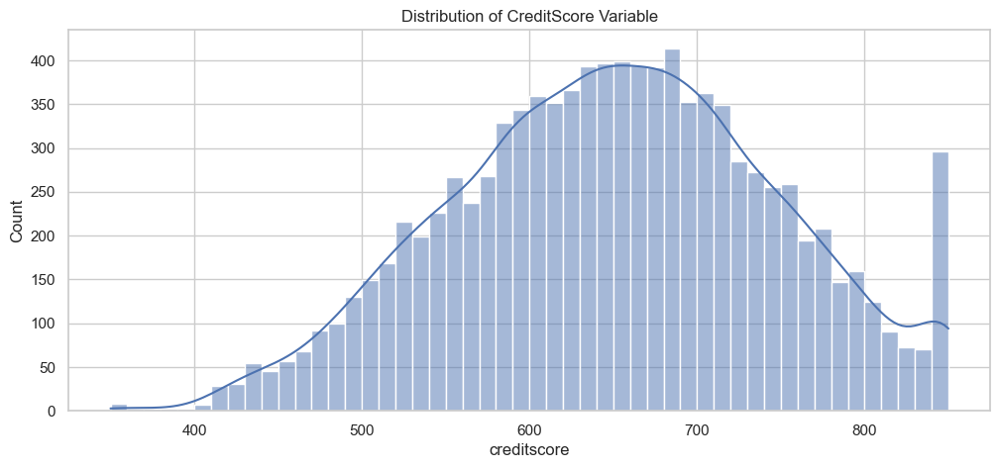

In [21]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['creditscore'], bins=50, kde=True)
plt.title(F'Distribution of CreditScore Variable')
plt.show()


#### ***Distribution of Credit Score – Insights***     
The distribution of credit scores among customers is approximately normal, peaking between 600 and 700, with the average around 650. A slight right skew indicates a few customers have very high scores, nearing the maximum of 850. There’s a notable spike at 850, possibly due to score capping or system-assigned limits. A small number of customers have very low scores below 450, indicating potential risk. Overall, most customers have moderate credit scores, with high scorers being low-risk and valuable for retention efforts.

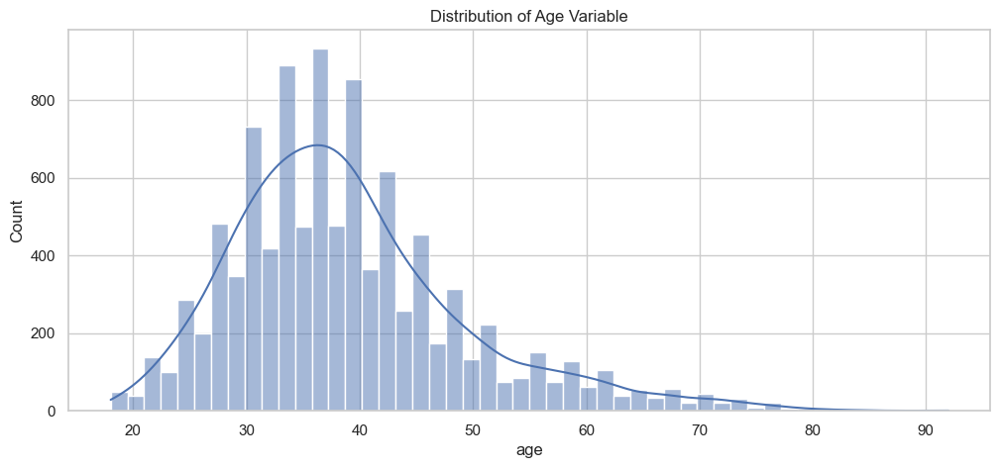

In [22]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['age'], bins=50, kde=True)
plt.title(F'Distribution of Age Variable')
plt.show()



#### ***Distribution of age – Insights***
The age distribution of customers is right-skewed, with the majority falling between the ages of 25 and 40. The highest concentration is around 35 years old. Very few customers are above 60, and those under 25 are also less common. This suggests that the company primarily serves a younger to middle-aged demographic, possibly indicating a target market of financially active individuals in their early careers or mid-life stages.

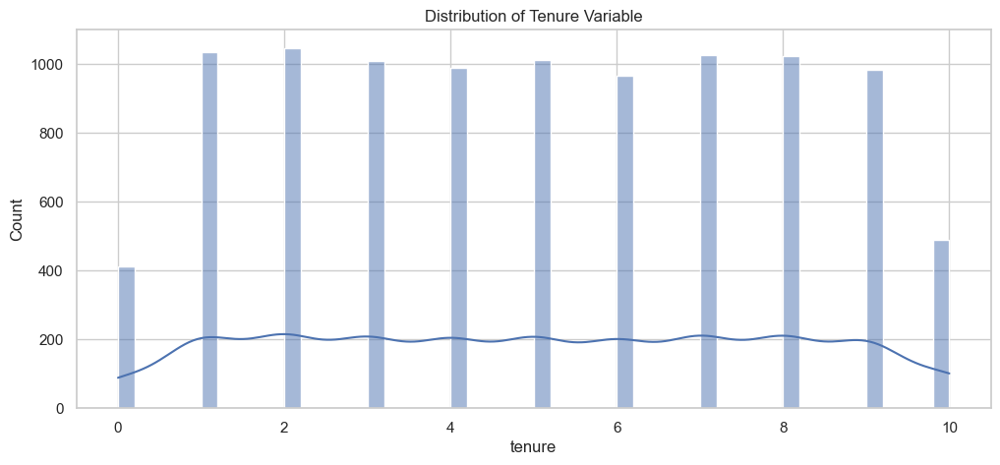

In [23]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['tenure'], bins=50, kde=True)
plt.title(F'Distribution of Tenure Variable')
plt.show()


#### ***Distribution of tenure – Insights***
The tenure distribution appears fairly uniform between 1 and 9 years, indicating that the company has a balanced mix of both relatively new and long-term customers. However, there is a noticeable drop in the number of customers with 0 or 10 years of tenure, suggesting that fewer customers are either brand new or have stayed the full duration. This could imply steady customer acquisition and retention, but perhaps some churn before the 10-year mark.

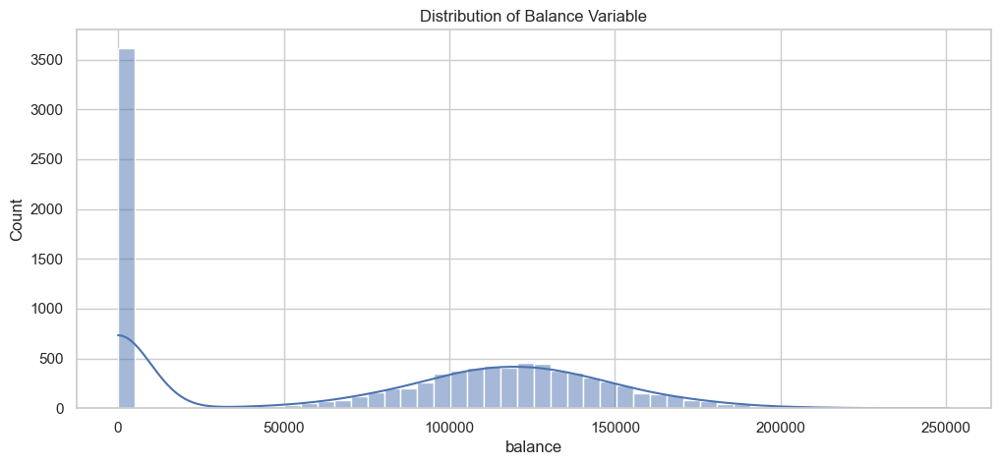

In [24]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['balance'], bins=50, kde=True)
plt.title(F'Distribution of Balance Variable')
plt.show()


#### ***Distribution of balance – Insights***
The balance distribution is highly right-skewed, with a significant spike at zero, indicating that a large portion of customers (over 3,500) have no balance in their account. Beyond zero, the distribution forms a bell-shaped curve, peaking between ₹100,000 and ₹150,000. This suggests that while many customers maintain moderate to high balances, a substantial group either keeps no money in their account or rarely uses it, which could be an indicator of disengagement or potential churn.

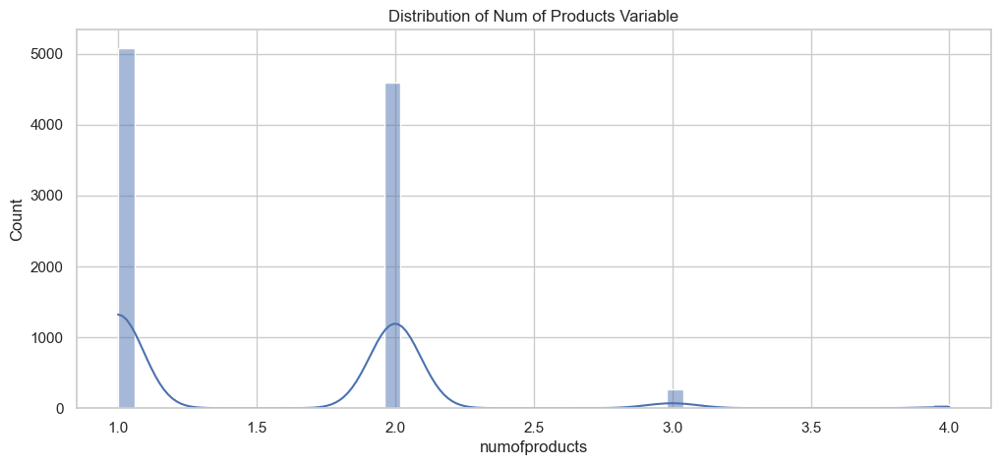

In [25]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['numofproducts'], bins=50, kde=True)
plt.title(F'Distribution of Num of Products Variable')
plt.show()


#### ***Distribution of numofproducts – Insights***
The numofproducts distribution is highly right-skewed and exhibits a multi-modal pattern with clear peaks at 1 and 2. A large portion of customers have only 1 product, followed closely by those with 2 products. Very few customers hold 3 or 4 products, indicating that most customers are not using multiple banking products offered by the institution.

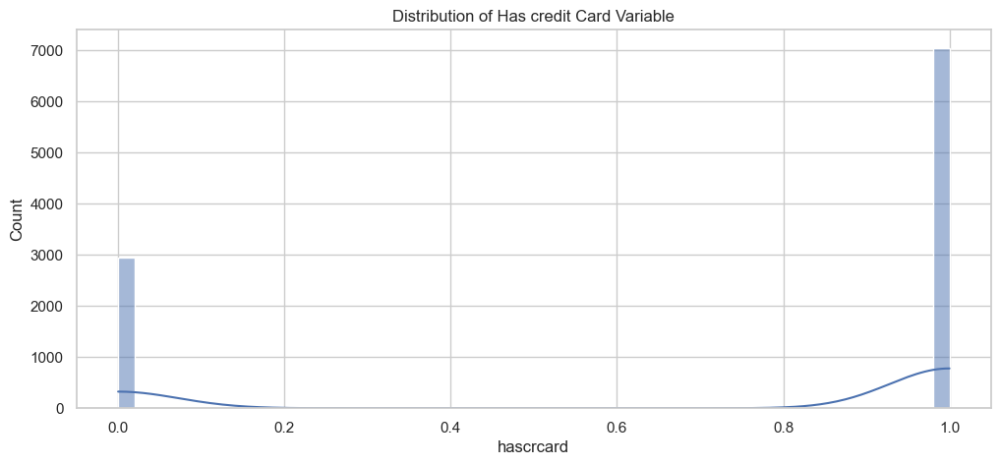

In [26]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['hascrcard'], bins=50, kde=True)
plt.title(F'Distribution of Has credit Card Variable')
plt.show()


#### ***Distribution of hascrcard – Insights***
The hascrcard variable is binary, indicating whether a customer owns a credit card (1) or not (0). The distribution is bimodal, with two distinct spikes—one at 0 and a larger one at 1. This tells us that most customers do have a credit card, while a smaller yet significant portion do not.

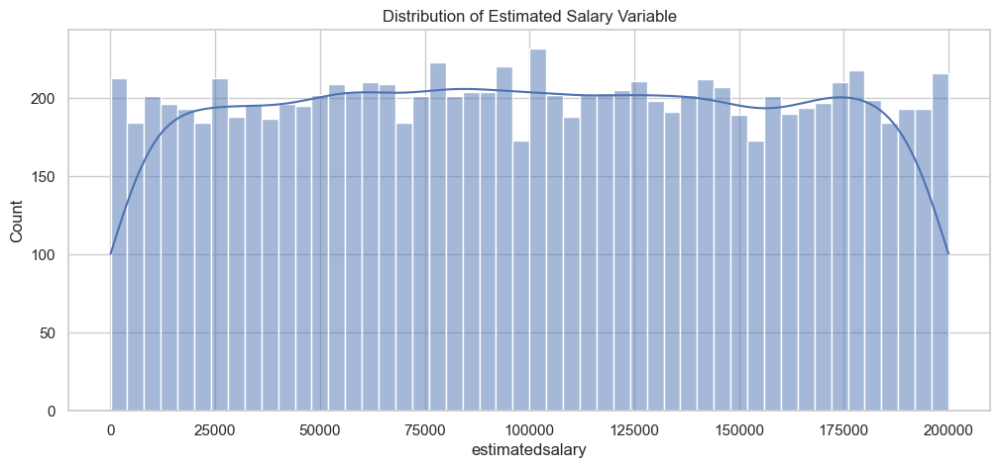

In [28]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['estimatedsalary'], bins=50, kde=True)
plt.title(F'Distribution of Estimated Salary Variable')
plt.show()


#### ***Distribution of estimatedsalary – Insights***
The distribution of the estimatedsalary variable appears to be fairly uniform, with values ranging between 0 and 200,000. The histogram shows that salaries are evenly spread across the entire range, without any significant peaks or clusters. This indicates that the dataset is not skewed toward any specific income group, providing a balanced representation of customers from all salary brackets.

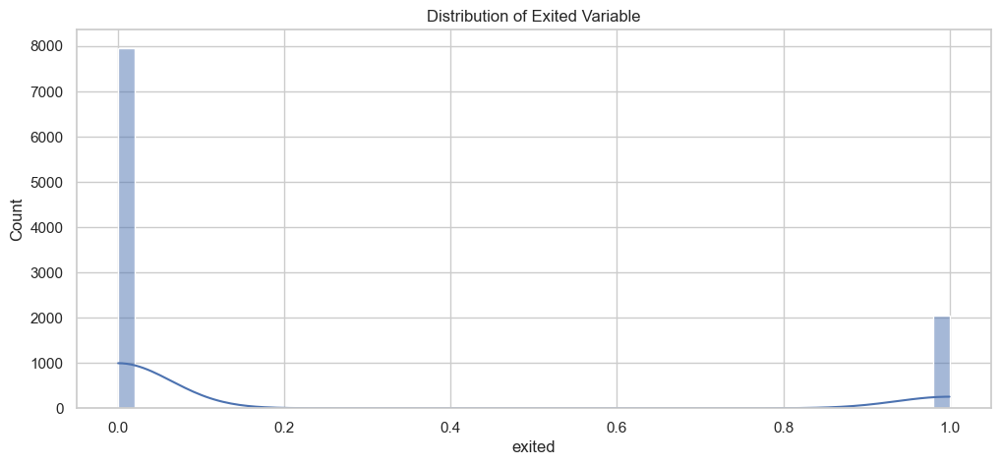

In [29]:

plt.figure(figsize=(12,5))
sns.histplot(clean_data['exited'], bins=50, kde=True)
plt.title(F'Distribution of Exited Variable')
plt.show()


#### ***Distribution of exited – Insights***
The distribution of the exited variable reveals a clear class imbalance within the dataset. The majority of customers, approximately 80%, did not exit the bank, while only around 20% of them actually left. This indicates that most customers chose to stay, suggesting a relatively stable customer base.

***
***Univariate Analysis*** - Categorical Features
***

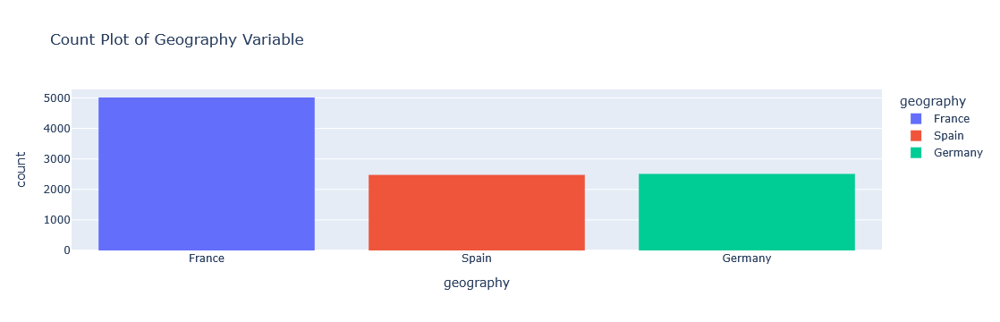

In [30]:

fig = px.histogram(clean_data, x='geography', title='Count Plot of Geography Variable',color='geography')
fig.show()


#### ***Distribution of geography – Insights***
`Dominant Group:` France has the highest count by a significant margin, with approximately 5014 individuals. This suggests that the dataset is heavily skewed towards individuals from France compared to Spain and Germany.

`Comparable Groups:` The counts for Spain (approximately 2477) and Germany (approximately 2509) are quite similar. The difference between these two groups is relatively small.

`Distribution:` The distribution across the three geographies is uneven. France represents a much larger portion of the dataset than either Spain or Germany individually. Combined, the counts for Spain and Germany are still slightly less than the count for France.

*In summary, the Distribution of geography indicates that individuals from France are the most represented geography, with Spain and Germany having roughly equal but considerably smaller representation.*

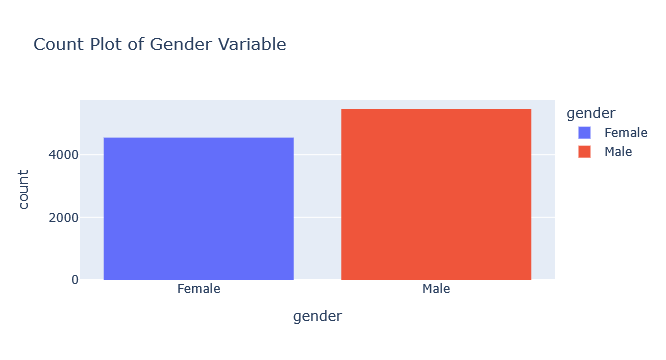

In [31]:

fig = px.histogram(clean_data, x='gender', title='Count Plot of Gender Variable',color='gender')
fig.show()


#### ***Distribution of gender – Insights***
The bar for "Male" (represented in orange) is noticeably taller than the bar for "Female" (represented in blue). This indicates that there are more males than females in this dataset.

***
***Bivariate Analysis:*** - Numerical vs. Numerical:
***

Correlation between creditscore and age: -0.00


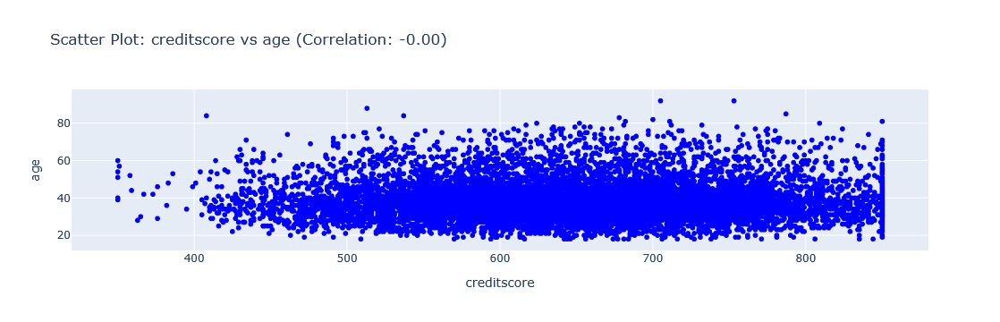

Correlation between creditscore and tenure: 0.00


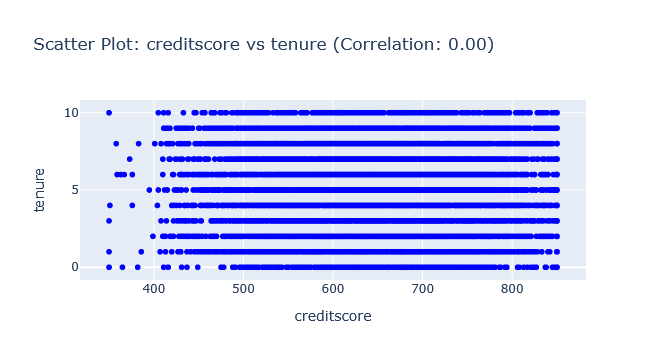

Correlation between creditscore and balance: 0.01


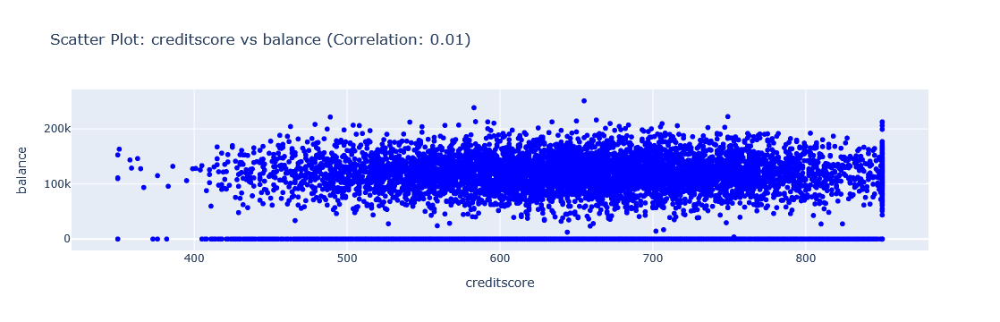

Correlation between creditscore and numofproducts: 0.01


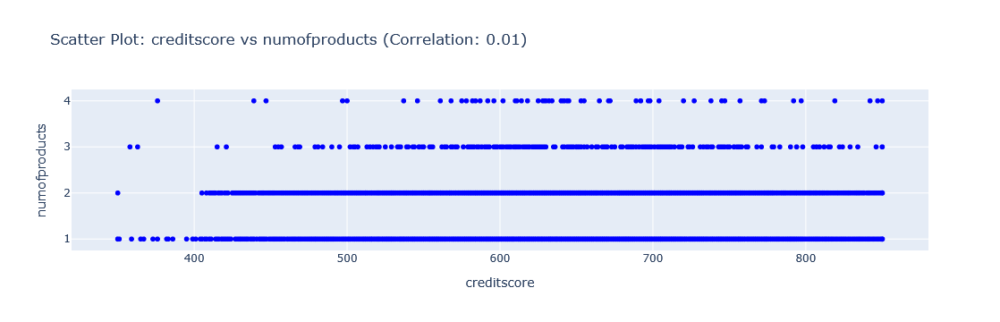

Correlation between creditscore and hascrcard: -0.01


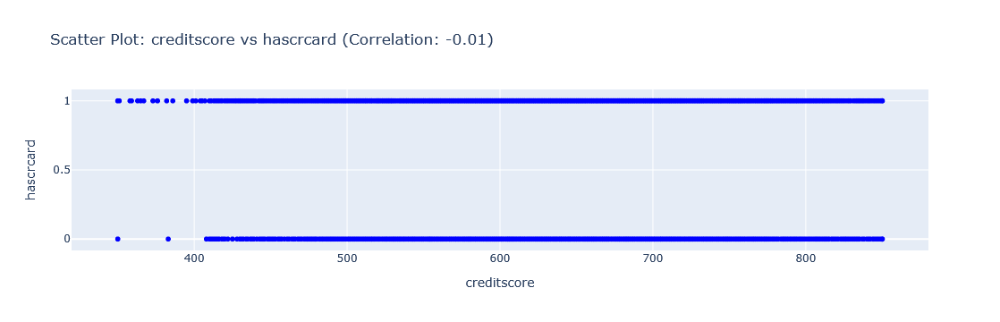

Correlation between creditscore and isactivemember: 0.03


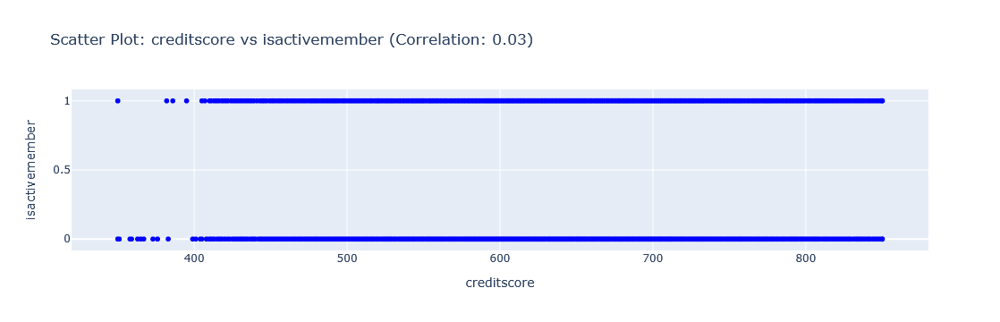

Correlation between creditscore and estimatedsalary: -0.00


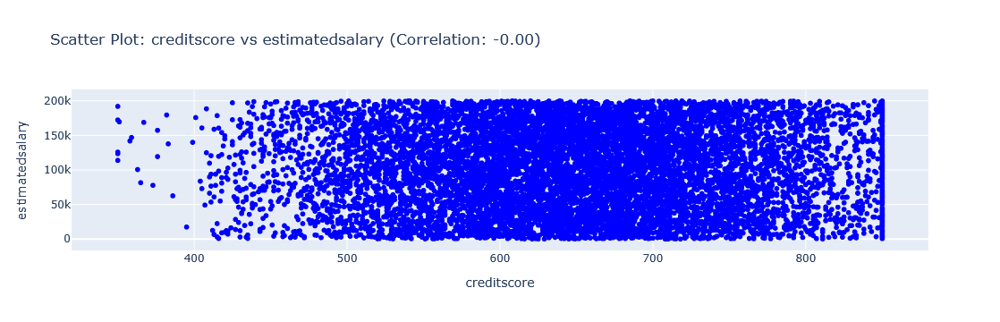

Correlation between creditscore and exited: -0.03


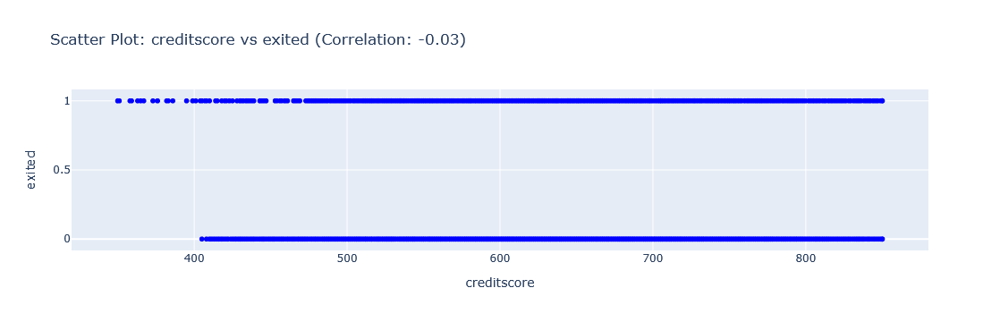

Correlation between age and tenure: -0.01


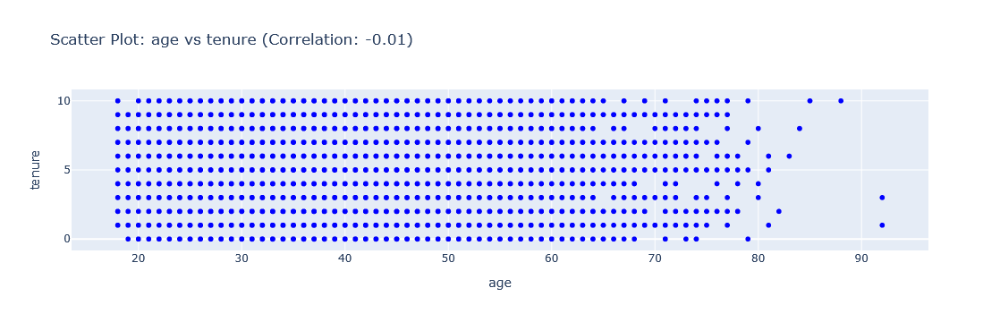

Correlation between age and balance: 0.03


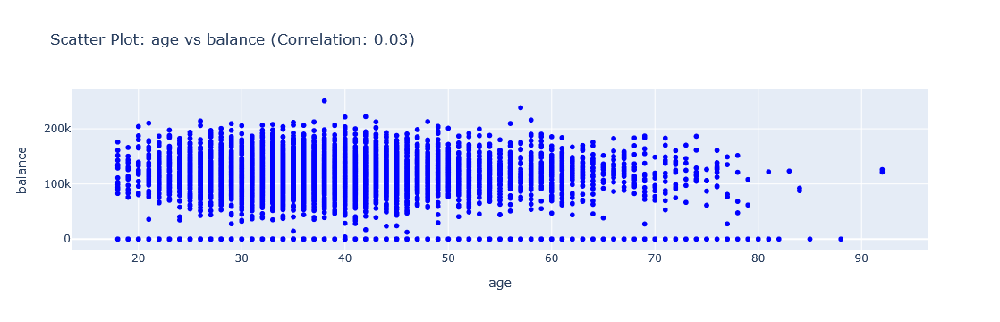

Correlation between age and numofproducts: -0.03


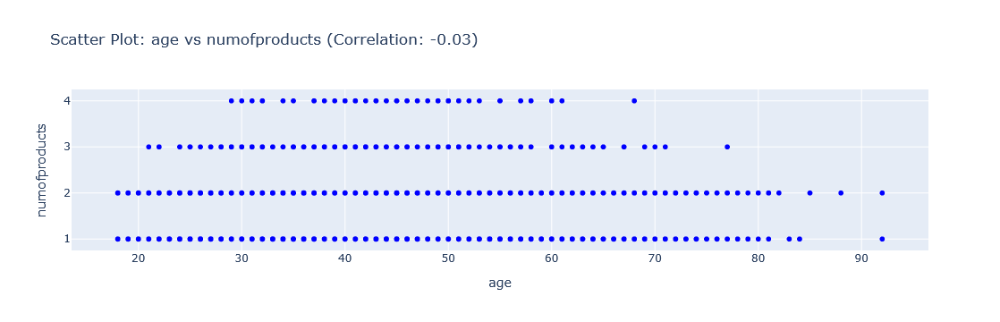

Correlation between age and hascrcard: -0.01


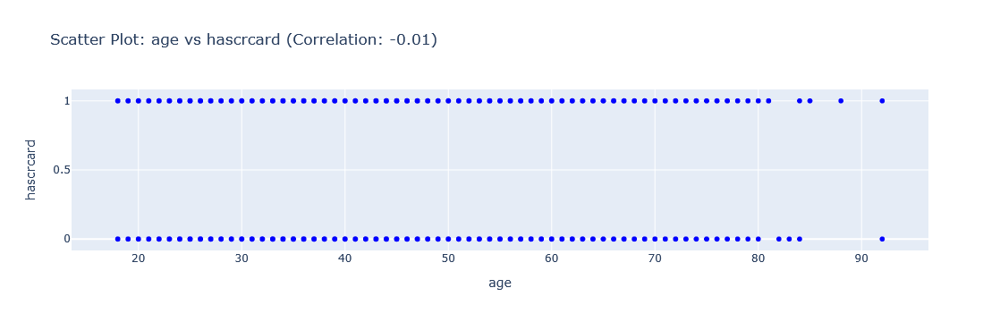

Correlation between age and isactivemember: 0.09


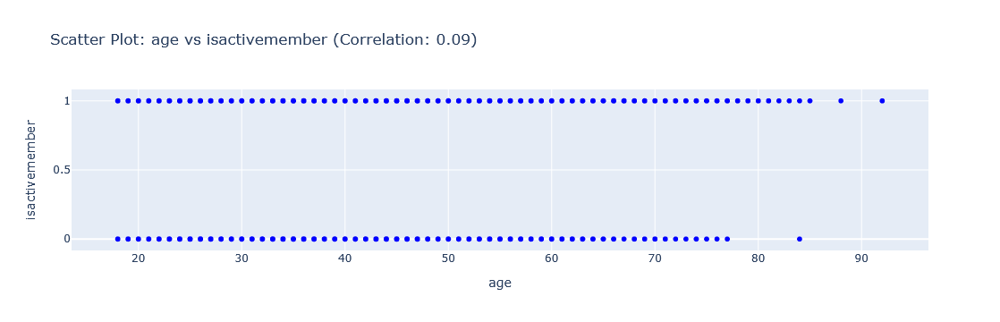

Correlation between age and estimatedsalary: -0.01


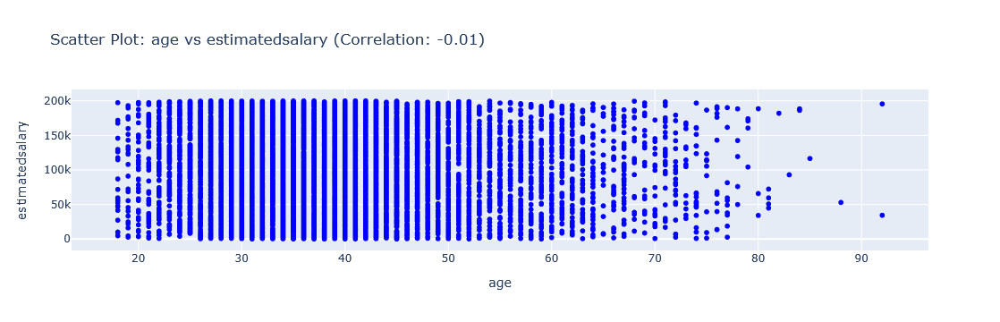

Correlation between age and exited: 0.29


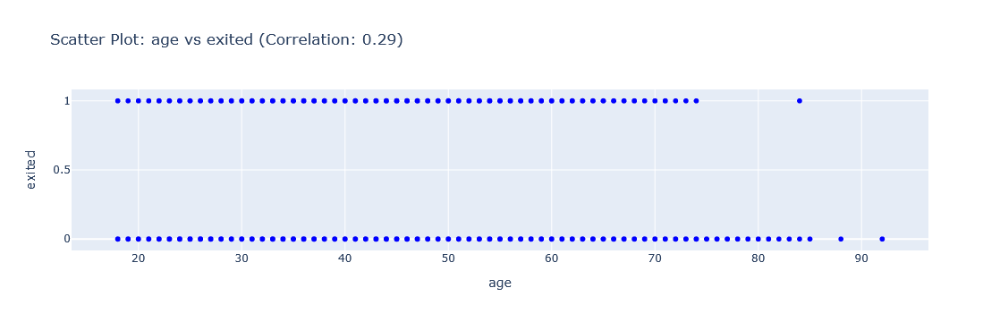

Correlation between tenure and balance: -0.01


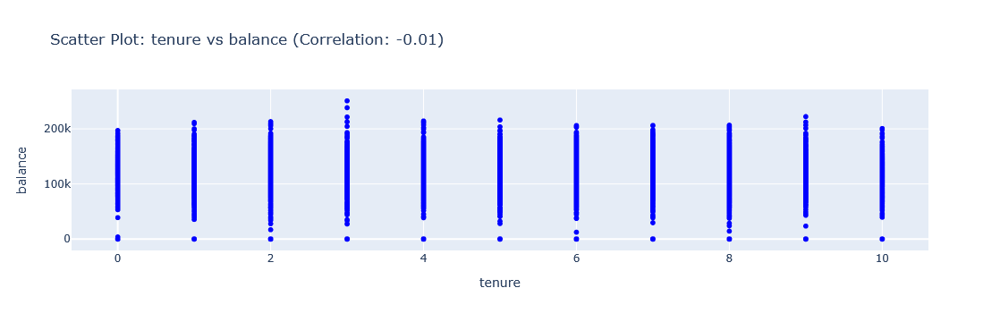

Correlation between tenure and numofproducts: 0.01


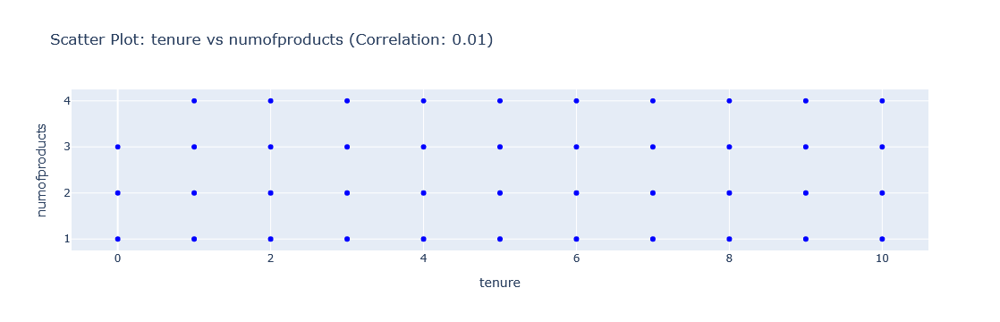

Correlation between tenure and hascrcard: 0.02


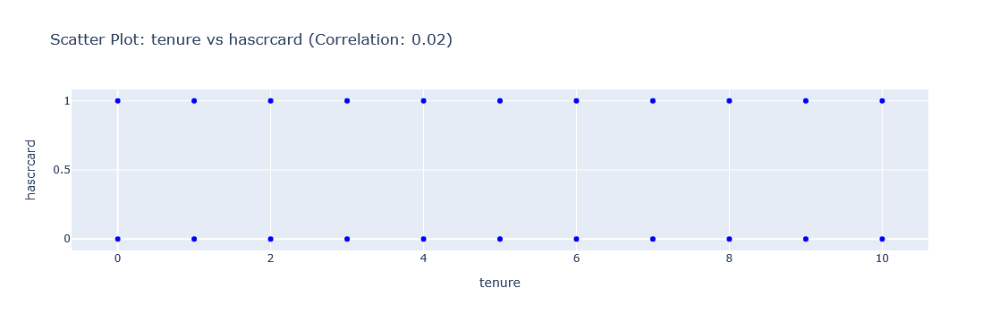

Correlation between tenure and isactivemember: -0.03


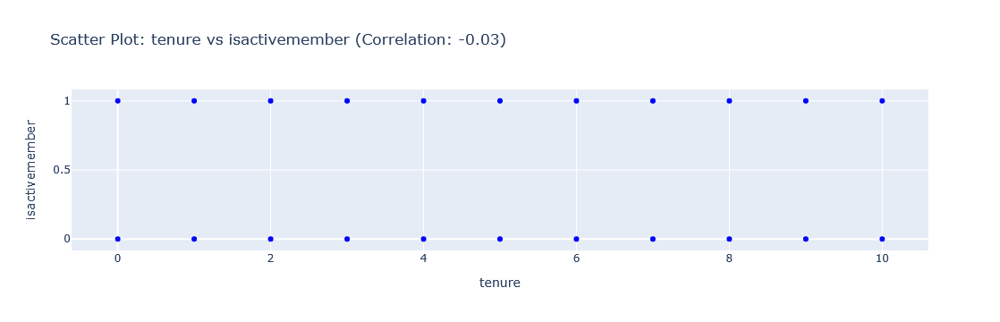

Correlation between tenure and estimatedsalary: 0.01


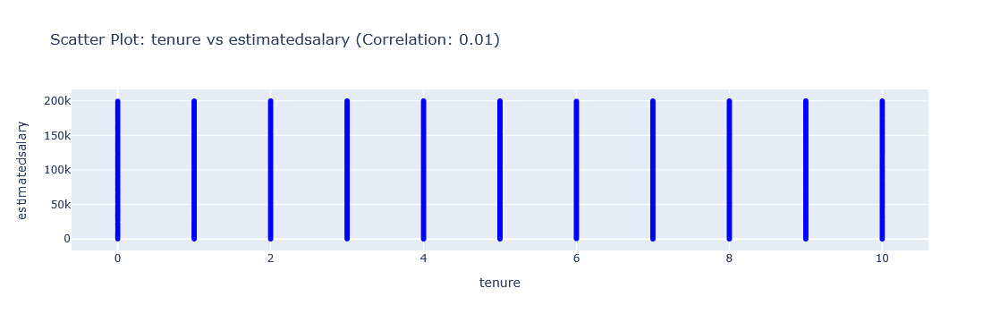

Correlation between tenure and exited: -0.01


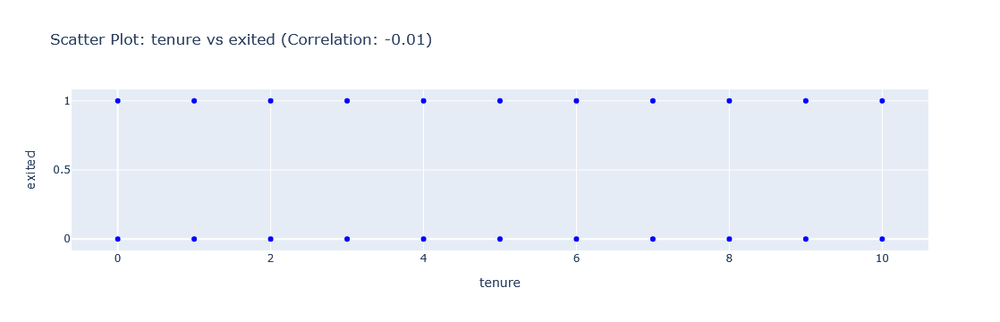

Correlation between balance and numofproducts: -0.30


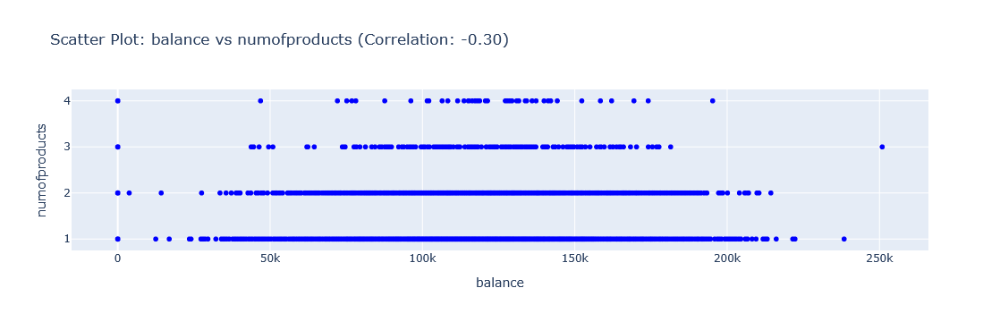

Correlation between balance and hascrcard: -0.01


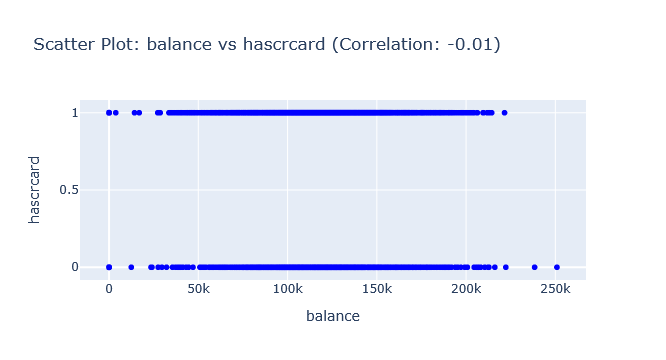

Correlation between balance and isactivemember: -0.01


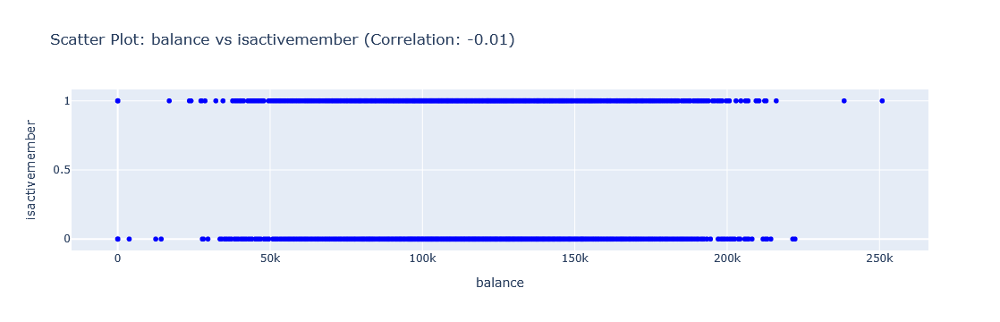

Correlation between balance and estimatedsalary: 0.01


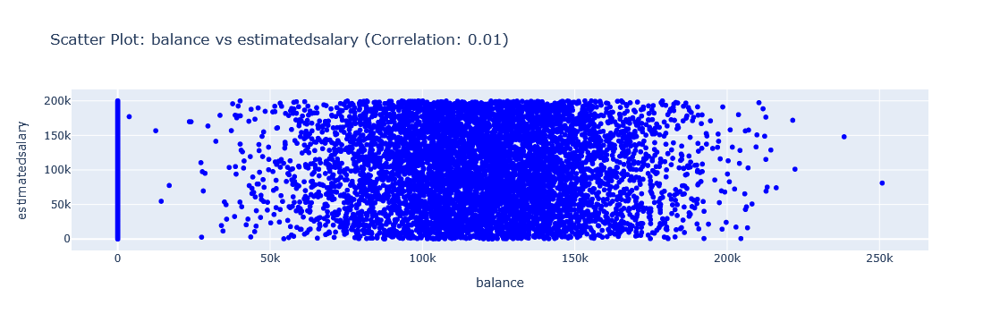

Correlation between balance and exited: 0.12


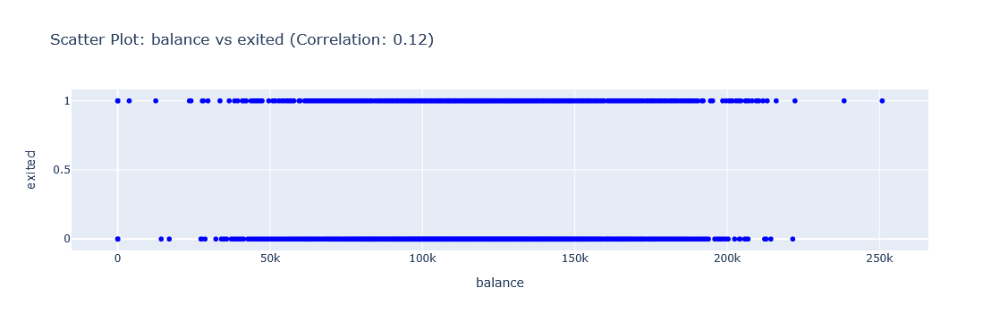

Correlation between numofproducts and hascrcard: 0.00


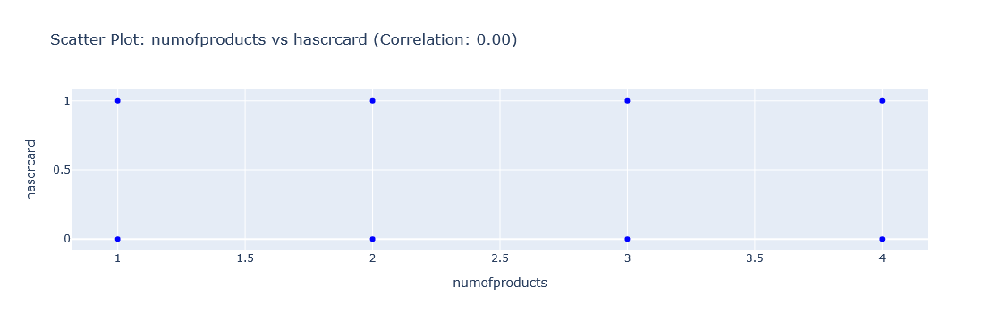

Correlation between numofproducts and isactivemember: 0.01


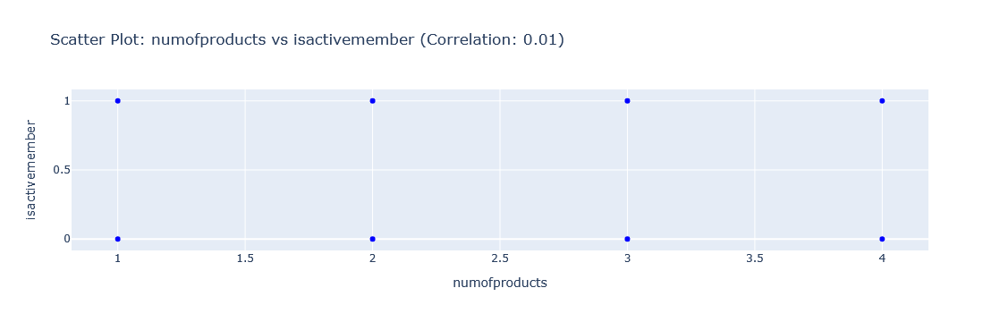

Correlation between numofproducts and estimatedsalary: 0.01


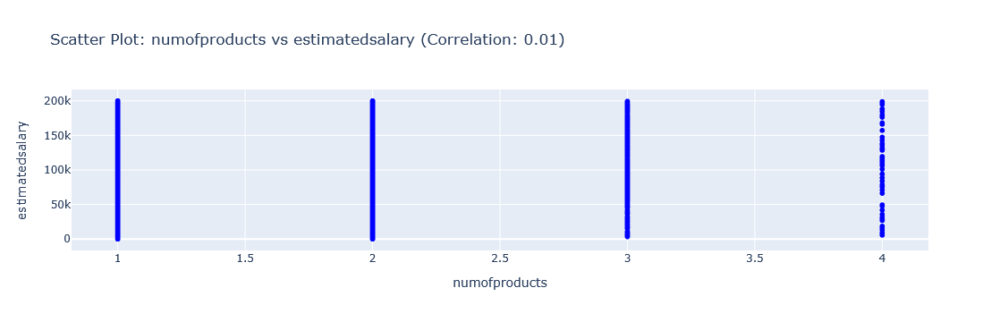

Correlation between numofproducts and exited: -0.05


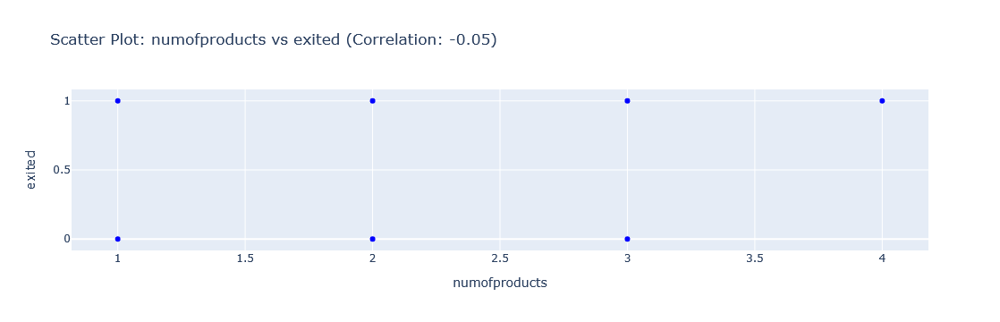

Correlation between hascrcard and isactivemember: -0.01


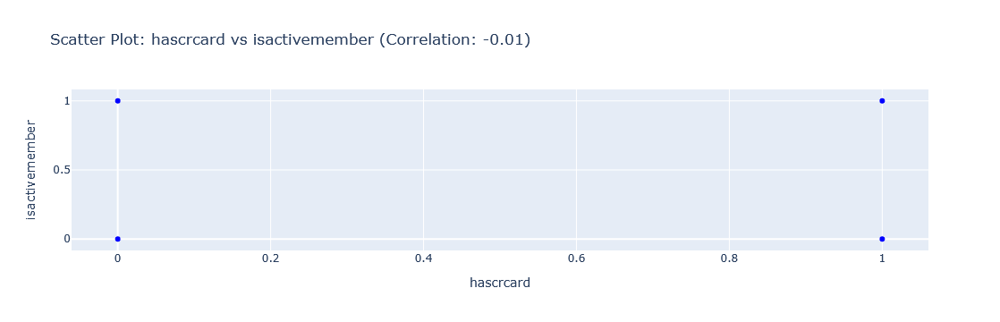

Correlation between hascrcard and estimatedsalary: -0.01


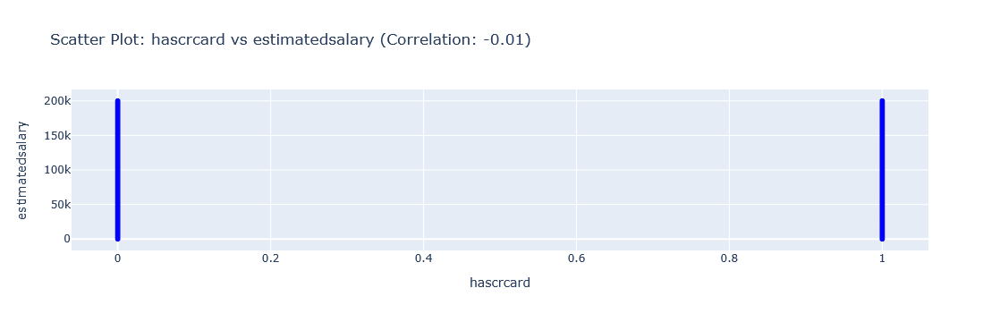

Correlation between hascrcard and exited: -0.01


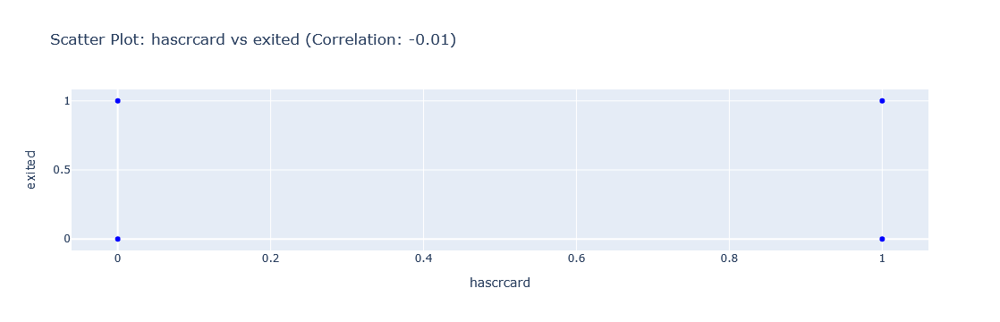

Correlation between isactivemember and estimatedsalary: -0.01


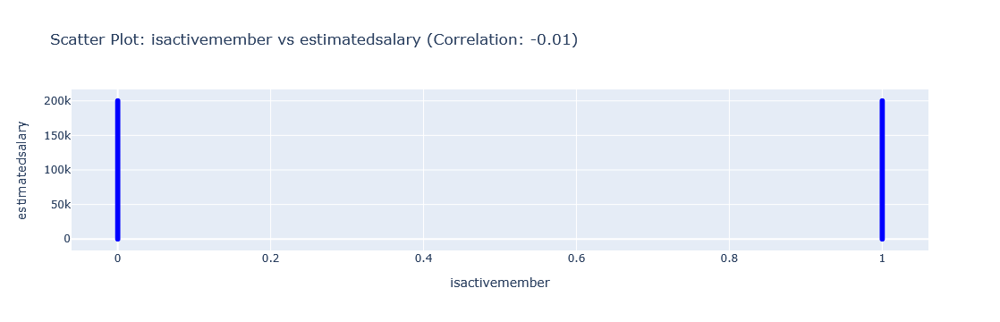

Correlation between isactivemember and exited: -0.16


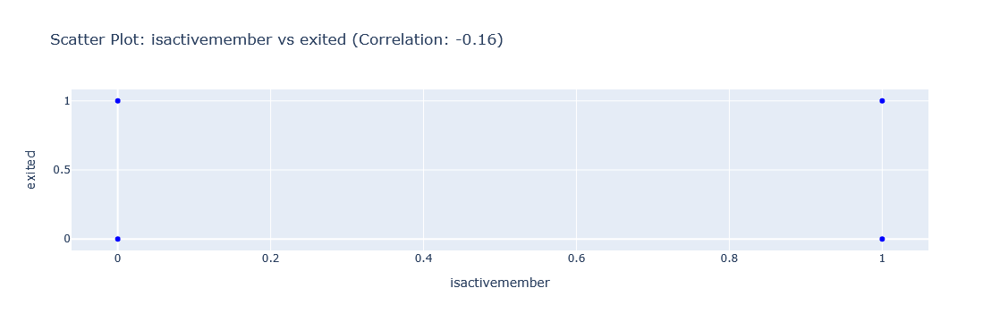

Correlation between estimatedsalary and exited: 0.01


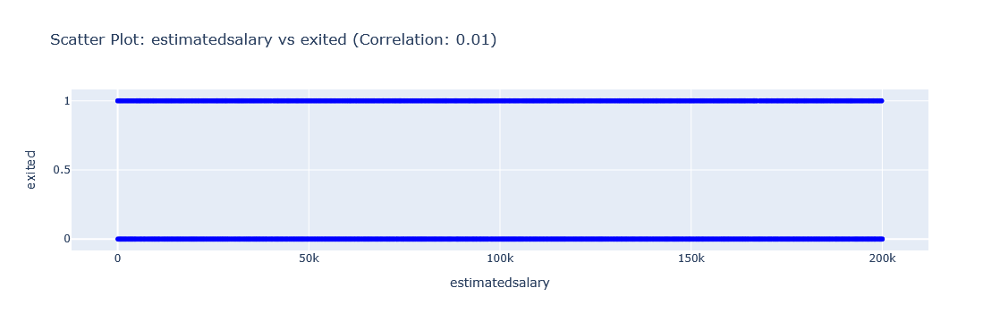

In [38]:

numerical_columns = clean_data.select_dtypes(include='number').columns

for i, col1 in enumerate(numerical_columns):
    for col2 in numerical_columns[i+1:]:
        correlation = clean_data[col1].corr(clean_data[col2])
        print(f"Correlation between {col1} and {col2}: {correlation:.2f}")
        # Scatter plot
        fig = px.scatter(
            clean_data, x=col1, y=col2,
            title=f'Scatter Plot: {col1} vs {col2} (Correlation: {correlation:.2f})',
            labels={col1: col1, col2: col2},
            color_discrete_sequence=["blue", "red"]
        )
        # Show the plot
        fig.show()
        

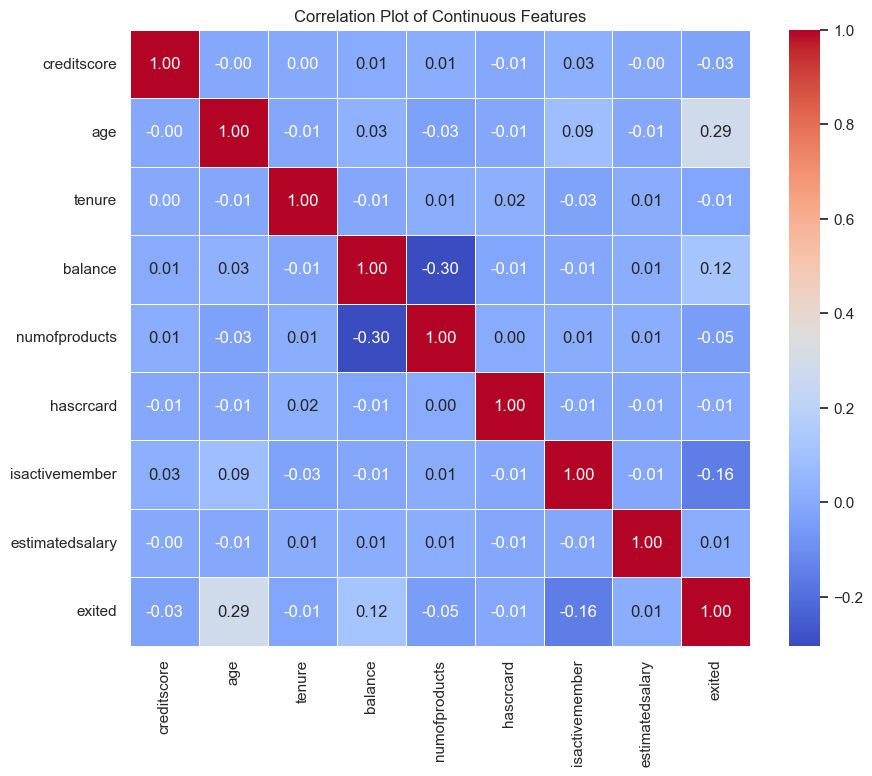

In [48]:

correlation_matrix = clean_data.select_dtypes(include='number').corr()

corr_matrix = correlation_matrix
plt.figure(figsize=(10,8))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title("Correlation Plot of Continuous Features")
plt.show()


The correlation heatmap highlights the relationships between continuous features in the dataset. Most features show `weak correlations` with each other, indicating `low multicollinearity`. Notably, age shows a `moderate positive correlation (0.29) with the target variable exited`, suggesting that **`older customers are slightly more likely to exit the bank`**. Additionally, **`isactivemember has a negative correlation of -0.16 with exited, implying that less active members are more likely to leave`**. The balance feature also shows a small positive correlation (0.12) with exited, hinting that customers with higher account balances may be more prone to churn. `balance and numofproducts` have a noticeable negative correlation (-0.30), possibly indicating that customers with more products tend to maintain lower balances.

***
***Bivariate Analysis:*** - Numerical vs. Categorical:
***

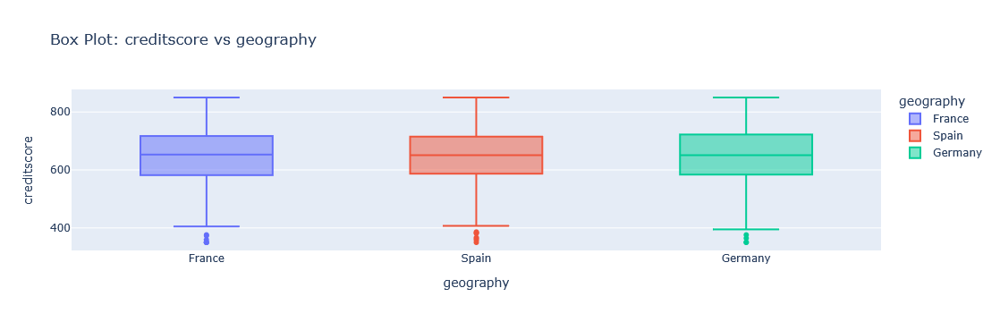

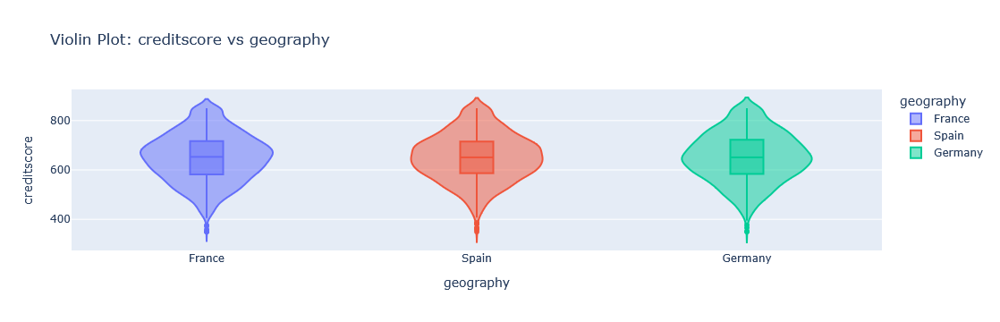

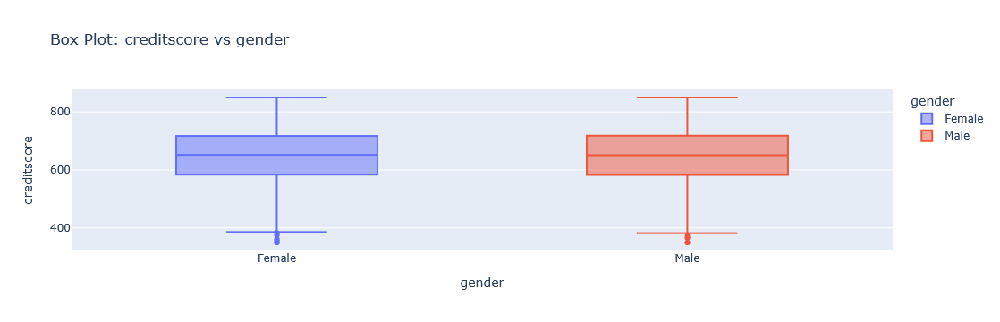

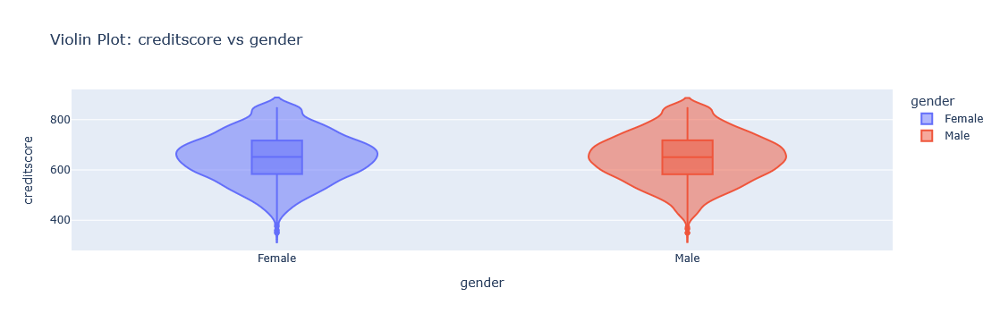

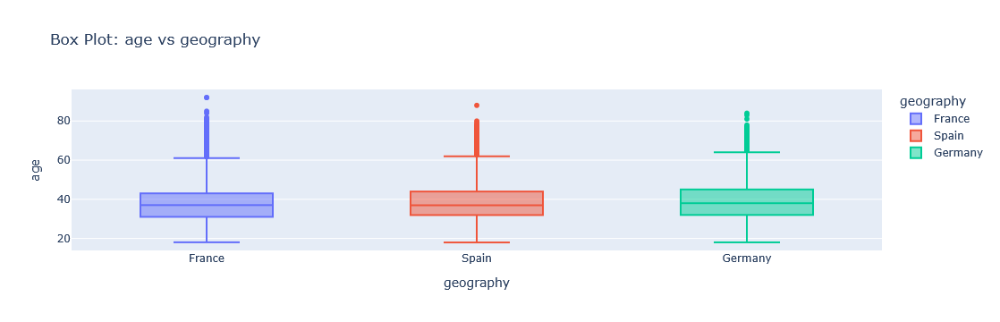

...

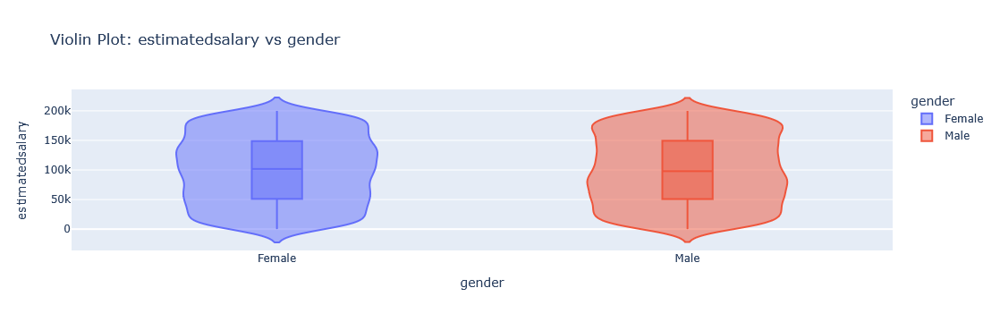

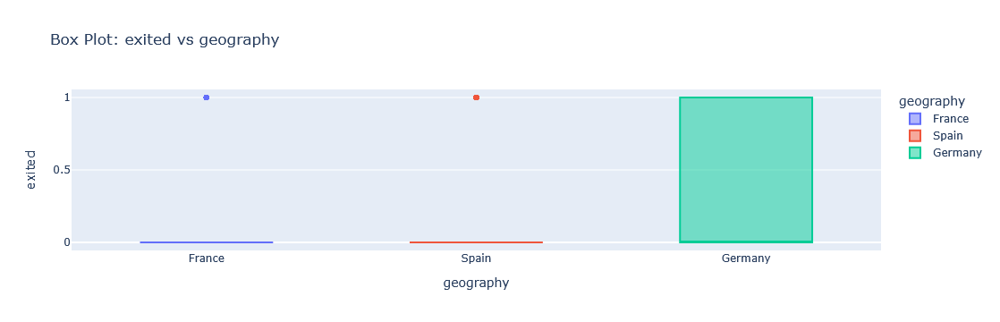

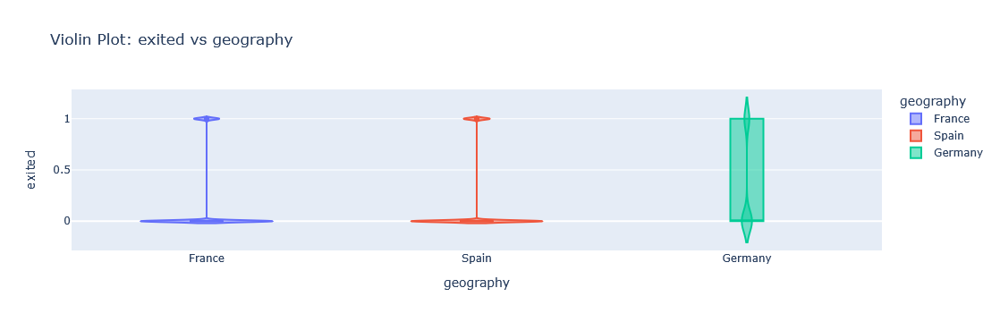

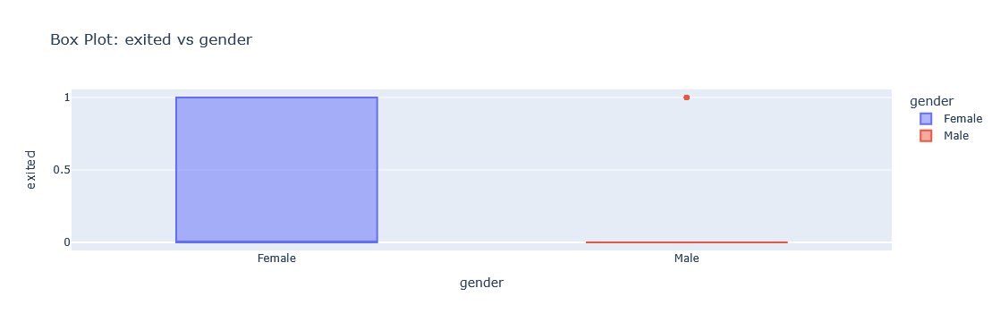

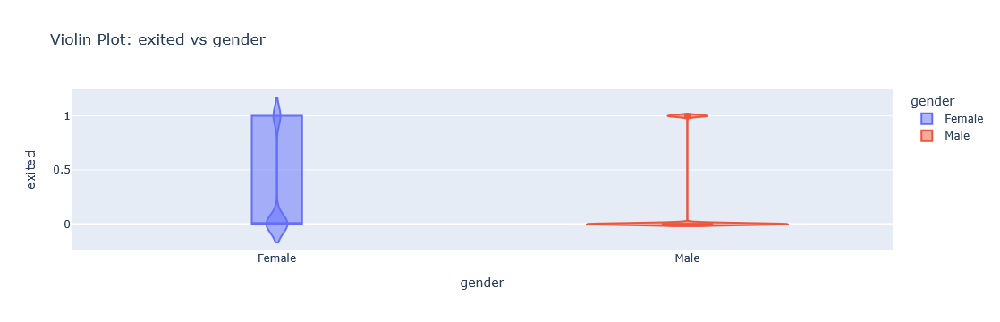

In [39]:
numerical_columns = clean_data.select_dtypes(include='number').columns
categorical_columns = clean_data.select_dtypes(include='object').columns

for num_col in numerical_columns:
    for cat_col in categorical_columns:
    
        fig1 = px.box(clean_data, x=cat_col, y=num_col, 
                      title=f'Box Plot: {num_col} vs {cat_col}',
                      labels={cat_col: cat_col, num_col: num_col}, 
                      color=cat_col)
        fig1.show()
        
        # Violin plot
        fig2 = px.violin(clean_data, x=cat_col, y=num_col,
                         title=f'Violin Plot: {num_col} vs {cat_col}',
                         labels={cat_col: cat_col, num_col: num_col},
                         color=cat_col, box=True)
        fig2.show()

***

### ***Summary of Insights***

***1. Class Distribution of Target Variable (exited):***        
The target variable is highly imbalanced:
- A large majority of customers did not exit (0).
- A smaller segment exited (1), indicating potential class imbalance that should be handled in modeling.

***2. Correlation with Churn (exited):***            
- Age has a moderate positive correlation (0.29) with churn —> older customers are more likely to exit.
- Balance shows a weak positive correlation (0.12) —> customers with higher balances tend to exit slightly more.
- IsActiveMember shows a negative correlation (-0.16) —> customers who are actively engaged are less likely to churn.

***3. Low Impact Features:***          
- `Credit Score`, `Tenure`, `HasCrCard`, `Number of Products`, `Estimated Salary` all show very weak or no correlation with churn, indicating limited individual predictive power.

#### ***Key Findings:***        
- The dataset suffers from class imbalance, which needs addressing during model building.
- Age, account balance, and activity status are the most influential features for predicting customer churn.
- Most features exhibit low correlation with each other and with churn, suggesting that non-linear models or feature interactions may be needed for better performance.



***
***